In [11]:
pip install ultralytics pymunk opencv-python

In [13]:
# Install ultralytics if not already installed
!pip install ultralytics
!pip install pymunk # Install pymunk

# Import necessary libraries
import torch
from ultralytics import YOLO
import cv2
import pymunk # This should now work after installing
import numpy as np

In [14]:
# YOLO 모델 로드
model = YOLO('/content/drive/MyDrive/AIFFEL_2024/Q-FIT/test_December_31/result/yolov8_billiard/weights/best.pt')  # 학습 완료된 YOLO 모델

In [15]:
# Pymunk 초기화 함수
def init_physics_engine():
    """
    Pymunk 공간 초기화.
    :return: 초기화된 Pymunk 공간
    """
    space = pymunk.Space()
    space.gravity = (0, -900)  # 중력 설정 (픽셀 단위로 작동)
    return space

In [16]:
# 물리 엔진 시뮬레이션 함수
def simulate_physics(space, detection_results, steps=50, dt=0.02):
    """
    Pymunk를 사용하여 경로 데이터를 계산합니다.
    :param space: Pymunk 공간
    :param detection_results: YOLO 검출 결과 리스트 [(x1, y1, x2, y2, confidence, class_id), ...]
    :param steps: 시뮬레이션 스텝 수
    :param dt: 시뮬레이션 타임 스텝 (초)
    :return: 경로 데이터 리스트
    """
    paths = []
    for obj in detection_results:
        x1, y1, x2, y2, confidence, class_id = obj
        center_x = (x1 + x2) / 2
        center_y = (y1 + y2) / 2

        # Pymunk Circle 객체 생성
        mass = 1
        radius = 10  # 공 반지름
        moment = pymunk.moment_for_circle(mass, 0, radius)
        body = pymunk.Body(mass, moment)
        body.position = center_x, center_y

        # 초기 속도 설정 (랜덤 방향)
        body.velocity = np.random.uniform(-200, 200), np.random.uniform(-200, 200)

        shape = pymunk.Circle(body, radius)
        shape.elasticity = 0.9  # 탄성
        shape.friction = 0.5   # 마찰
        space.add(body, shape)

        # 시뮬레이션 실행
        object_path = []
        for _ in range(steps):
            space.step(dt)
            object_path.append((body.position.x, body.position.y))

        paths.append({
            "class_id": class_id,
            "path": object_path
        })

    return paths

In [17]:
# 비디오에서 객체 검출 및 물리 엔진 활용
def process_video(video_path, output_path):
    """
    비디오에서 객체를 검출하고 물리 엔진을 사용하여 경로 데이터를 생성합니다.
    :param video_path: 입력 비디오 경로
    :param output_path: 출력 비디오 경로
    """
    cap = cv2.VideoCapture(video_path)
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

    space = init_physics_engine()  # Pymunk 초기화

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # YOLO로 객체 검출
        results = model(frame)
        detection_results = []
        for r in results:  # 결과는 Result 객체 리스트로 반환됩니다
            for box in r.boxes:  # 각 결과에서 박스 정보를 가져옵니다
                x1, y1, x2, y2 = box.xyxy[0]  # 좌표
                confidence = box.conf[0]      # 신뢰도
                class_id = box.cls[0]         # 클래스 ID
                detection_results.append((x1.item(), y1.item(), x2.item(), y2.item(), confidence.item(), int(class_id.item())))

        # 물리 엔진을 통한 경로 계산
        paths = simulate_physics(space, detection_results)

        # 시각화 및 결과 저장
        for path_info in paths:
            for point in path_info["path"]:
                cv2.circle(frame, (int(point[0]), int(point[1])), 3, (0, 255, 0), -1)

        out.write(frame)
        cv2.imshow('Processed Frame', frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

In [19]:
from google.colab.patches import cv2_imshow

# 비디오에서 객체 검출 및 물리 엔진 활용
def process_video(video_path, output_path):
    """
    비디오에서 객체를 검출하고 물리 엔진을 사용하여 경로 데이터를 생성합니다.
    :param video_path: 입력 비디오 경로
    :param output_path: 출력 비디오 경로
    """
    cap = cv2.VideoCapture(video_path)
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

    space = init_physics_engine()  # Pymunk 초기화

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # YOLO로 객체 검출
        results = model(frame)
        detection_results = []
        for r in results:  # 결과는 Result 객체 리스트로 반환됩니다
            for box in r.boxes:  # 각 결과에서 박스 정보를 가져옵니다
                x1, y1, x2, y2 = box.xyxy[0]  # 좌표
                confidence = box.conf[0]      # 신뢰도
                class_id = box.cls[0]         # 클래스 ID
                detection_results.append((x1.item(), y1.item(), x2.item(), y2.item(), confidence.item(), int(class_id.item())))

        # 물리 엔진을 통한 경로 계산
        paths = simulate_physics(space, detection_results)

        # 시각화 및 결과 저장
        for path_info in paths:
            for point in path_info["path"]:
                cv2.circle(frame, (int(point[0]), int(point[1])), 3, (0, 255, 0), -1)

        out.write(frame)
        # Colab에서는 cv2_imshow를 사용하여 프레임을 표시
        cv2_imshow(frame)

    cap.release()
    out.release()
    cv2.destroyAllWindows()


0: 736x1280 1 frame, 2 red balls, 1 table, 1 white ball, 1 yellow ball, 1284.4ms
Speed: 14.4ms preprocess, 1284.4ms inference, 1.5ms postprocess per image at shape (1, 3, 736, 1280)


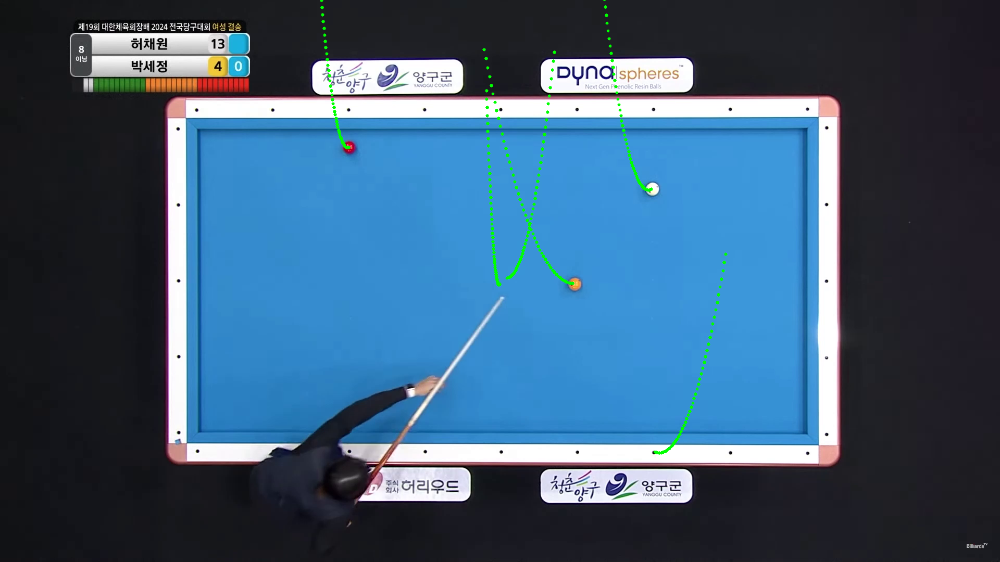


0: 736x1280 1 frame, 2 red balls, 1 table, 1 white ball, 1 yellow ball, 1354.0ms
Speed: 16.1ms preprocess, 1354.0ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


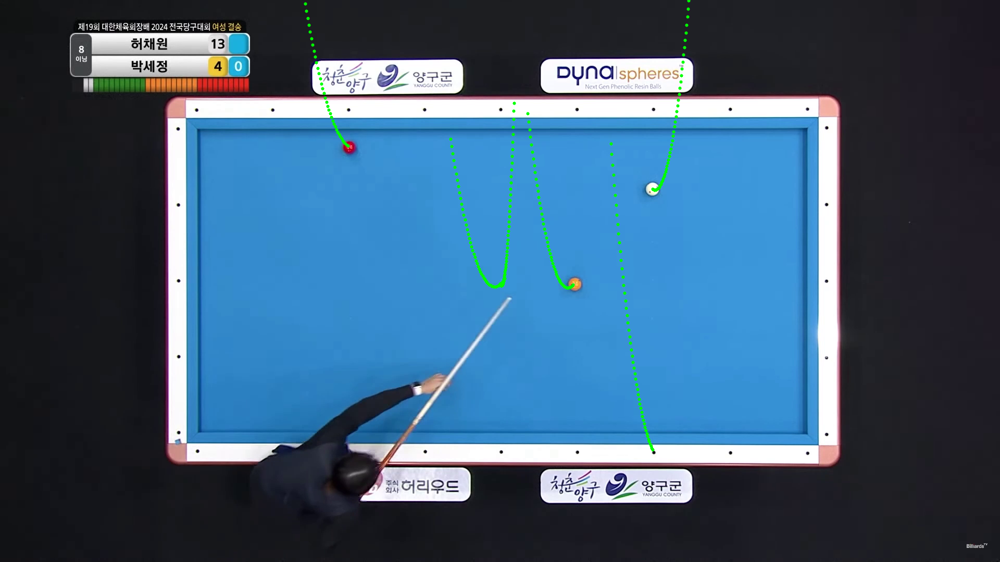


0: 736x1280 1 frame, 2 red balls, 1 table, 1 white ball, 1 yellow ball, 1436.9ms
Speed: 14.7ms preprocess, 1436.9ms inference, 1.4ms postprocess per image at shape (1, 3, 736, 1280)


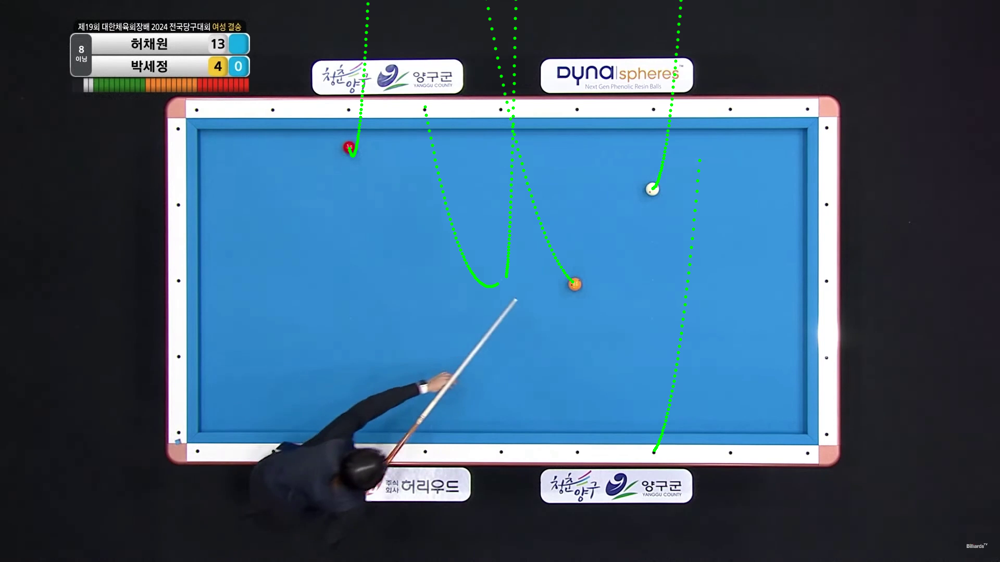


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1582.4ms
Speed: 22.0ms preprocess, 1582.4ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 1280)


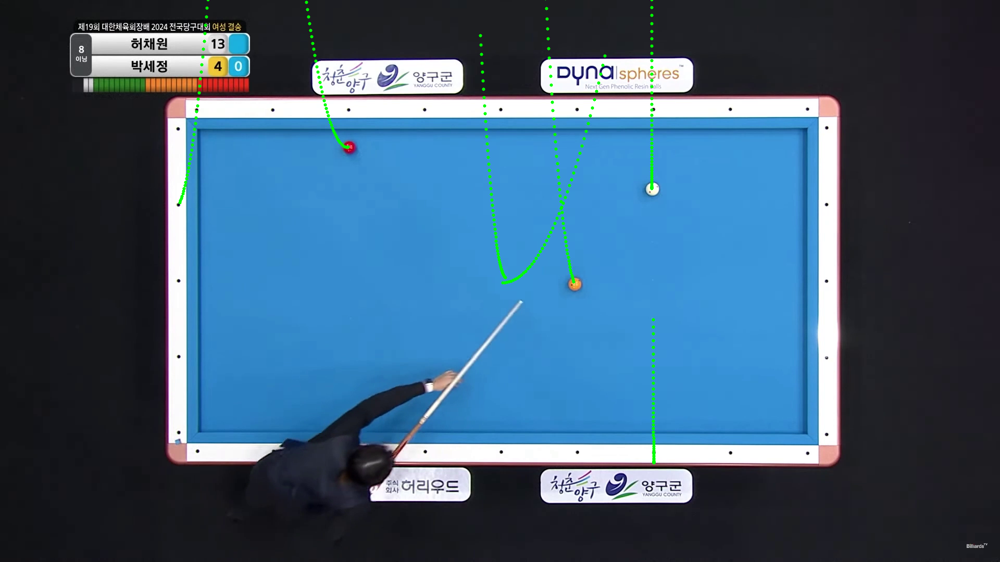


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1991.5ms
Speed: 16.2ms preprocess, 1991.5ms inference, 1.7ms postprocess per image at shape (1, 3, 736, 1280)


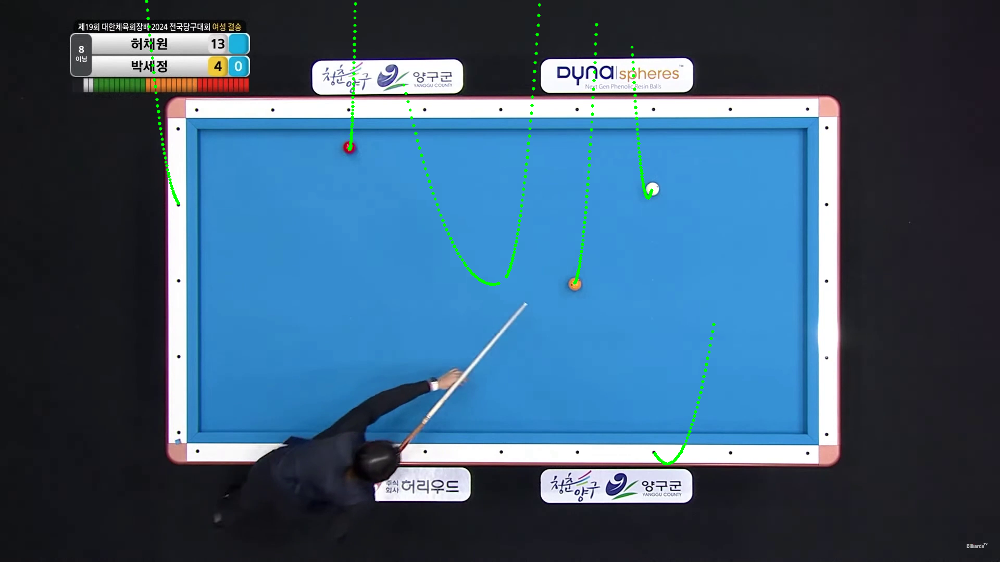


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 2048.1ms
Speed: 16.8ms preprocess, 2048.1ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)


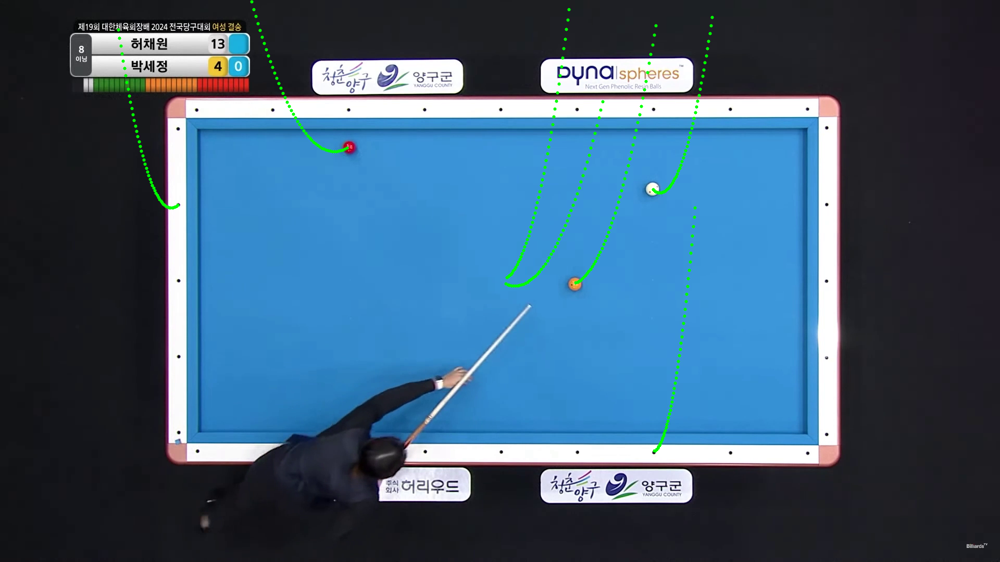


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1411.3ms
Speed: 13.3ms preprocess, 1411.3ms inference, 1.2ms postprocess per image at shape (1, 3, 736, 1280)


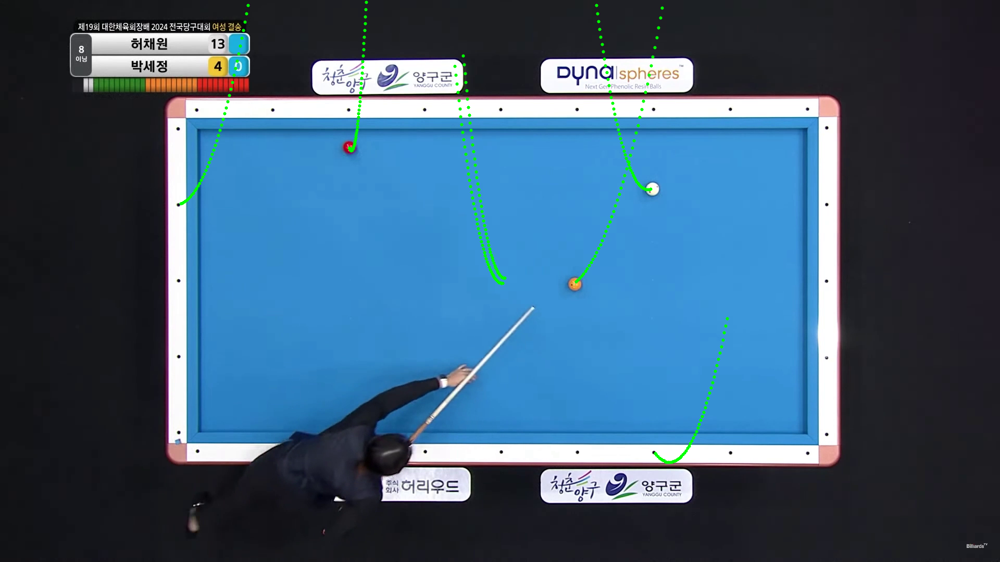


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1489.8ms
Speed: 13.7ms preprocess, 1489.8ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


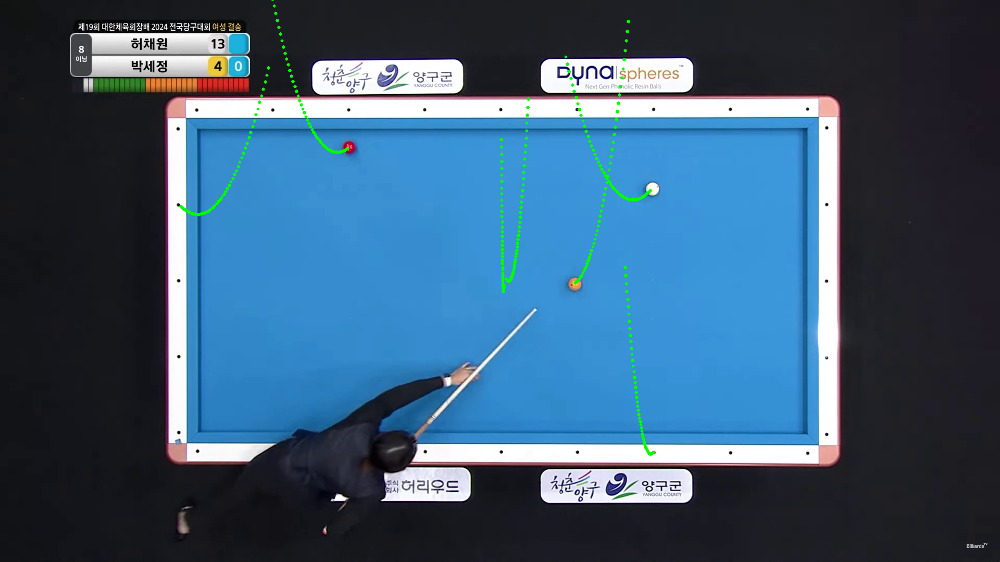


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1545.7ms
Speed: 13.7ms preprocess, 1545.7ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


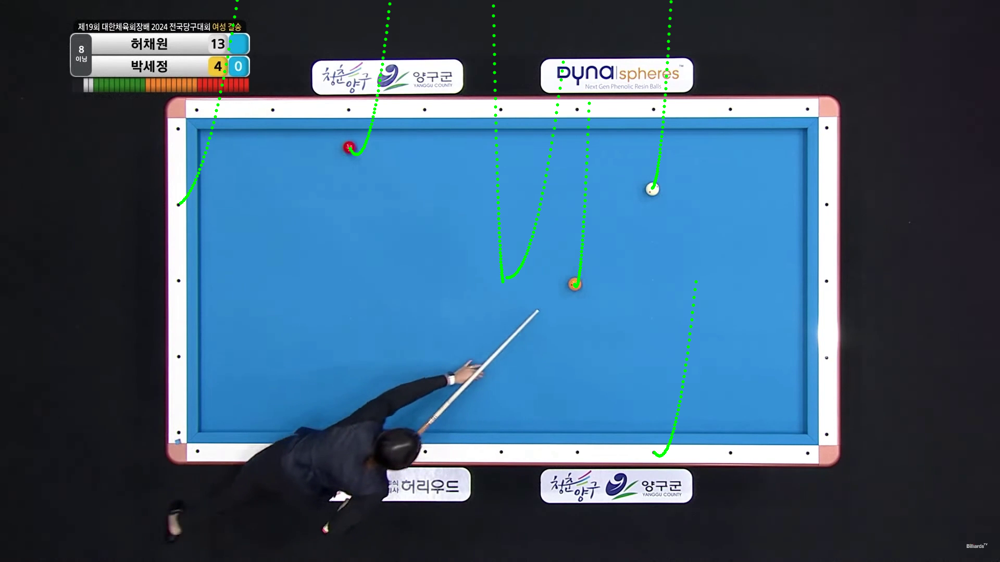


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1447.4ms
Speed: 12.6ms preprocess, 1447.4ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


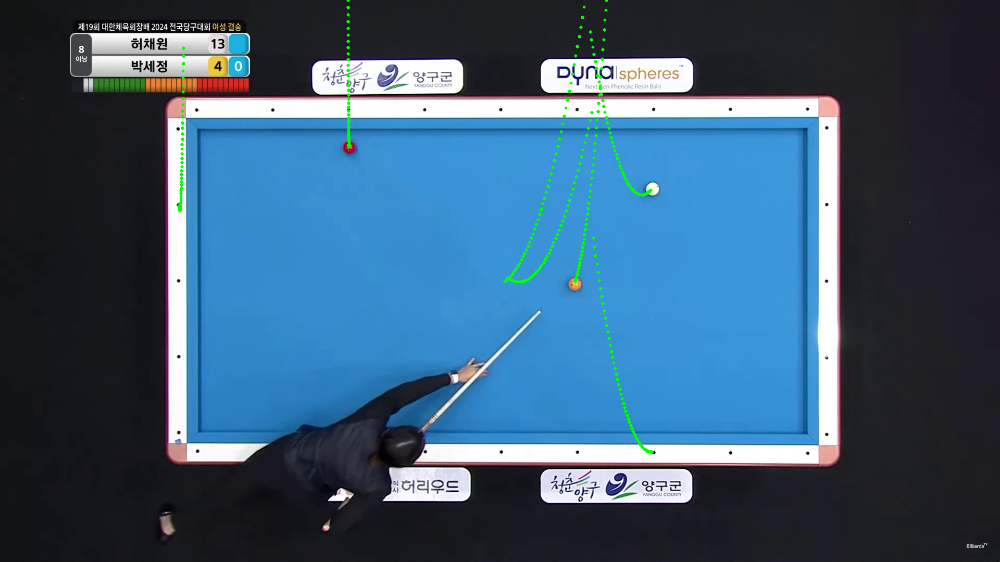


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1436.9ms
Speed: 15.7ms preprocess, 1436.9ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


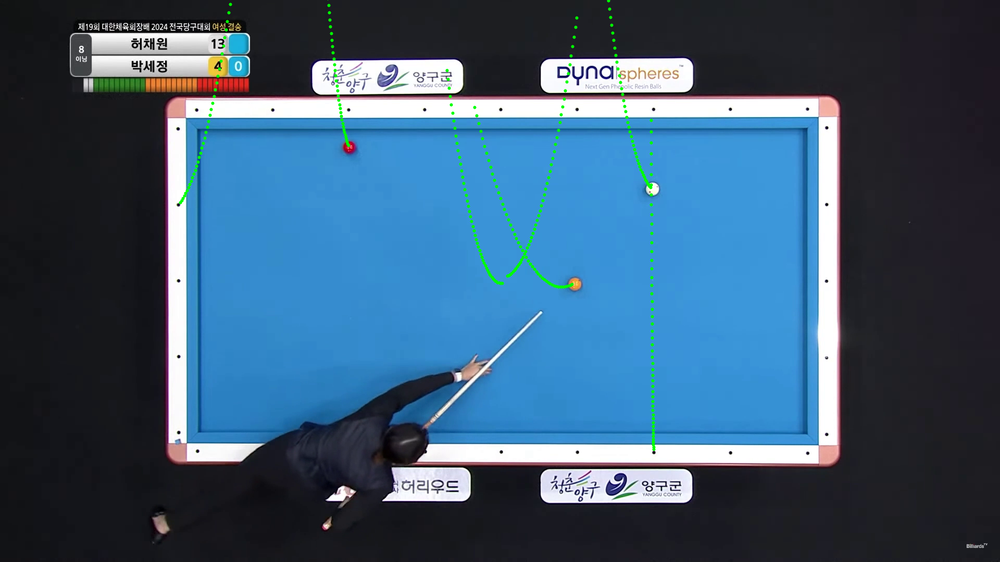


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1628.0ms
Speed: 12.7ms preprocess, 1628.0ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)


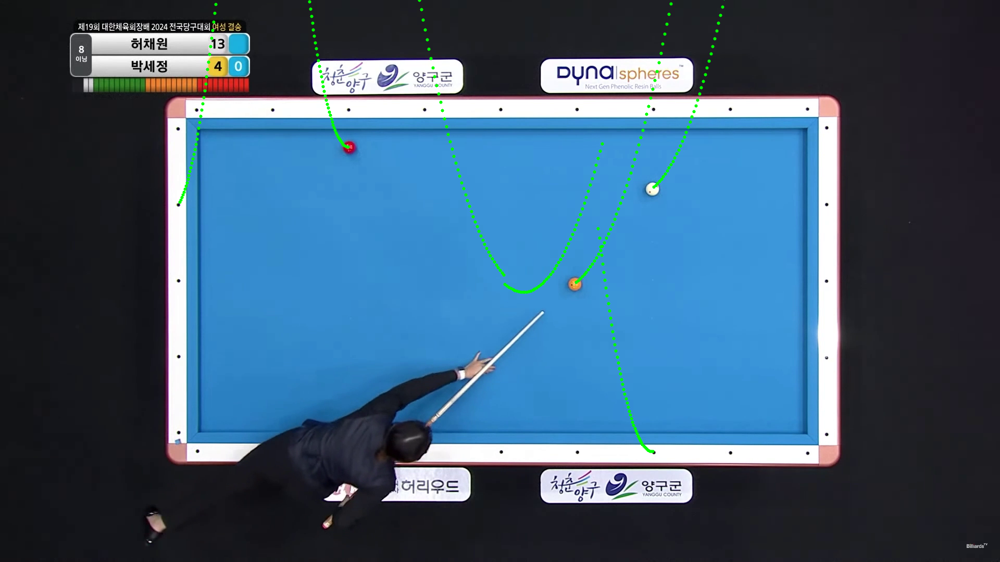


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 2053.0ms
Speed: 14.7ms preprocess, 2053.0ms inference, 1.6ms postprocess per image at shape (1, 3, 736, 1280)


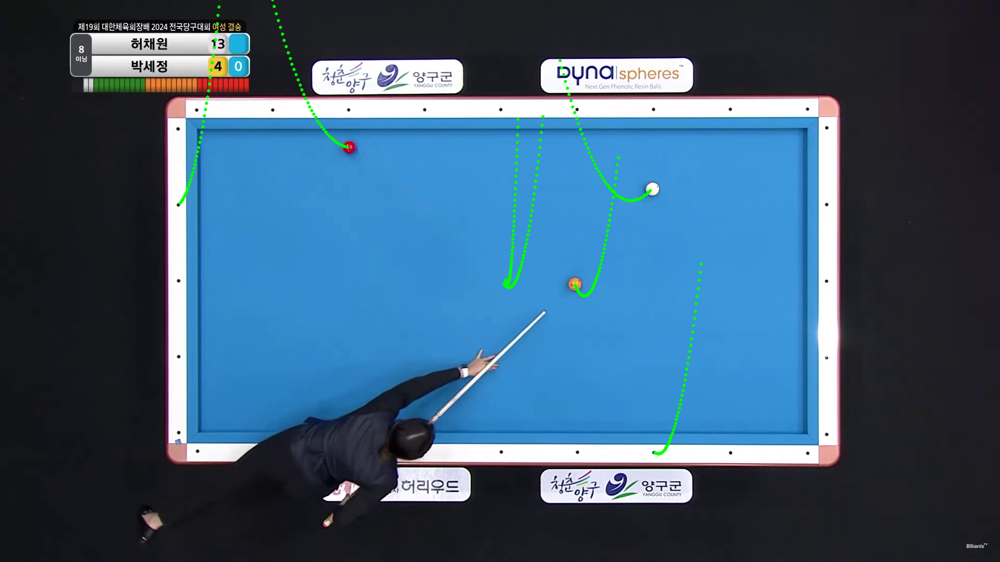


0: 736x1280 1 frame, 4 red balls, 1 table, 1 white ball, 1 yellow ball, 2206.9ms
Speed: 13.0ms preprocess, 2206.9ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)


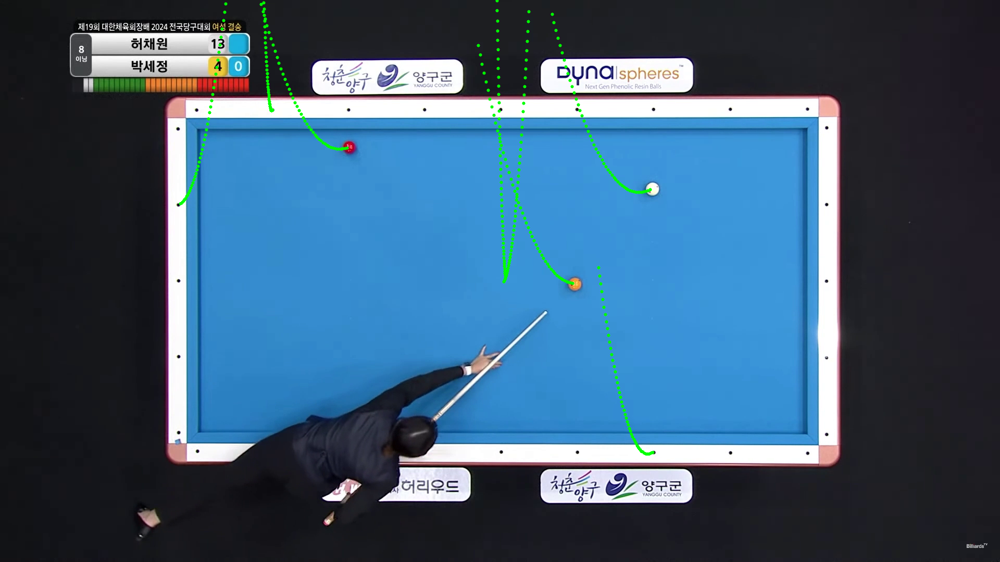


0: 736x1280 1 frame, 4 red balls, 1 table, 1 white ball, 1 yellow ball, 1908.9ms
Speed: 13.0ms preprocess, 1908.9ms inference, 1.1ms postprocess per image at shape (1, 3, 736, 1280)


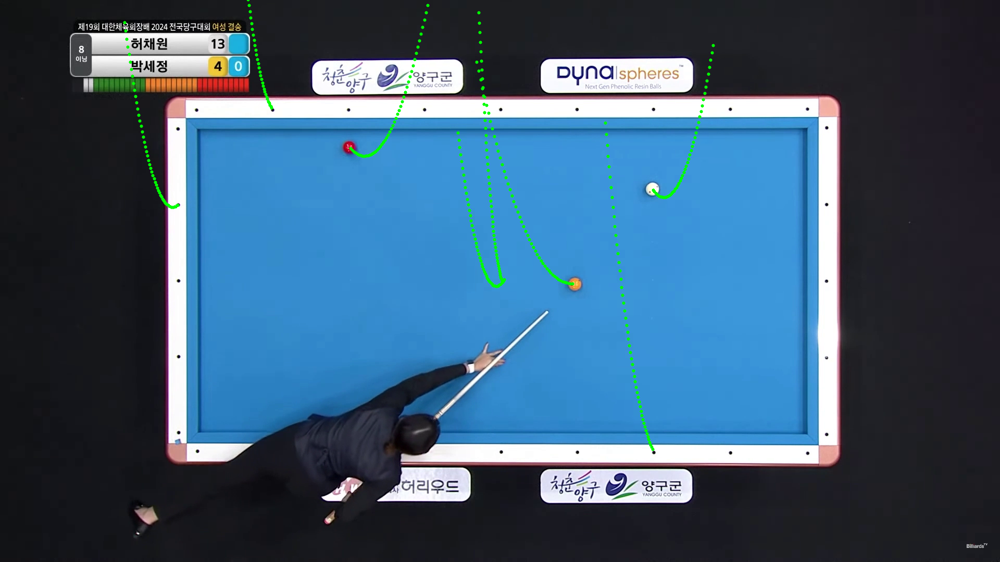


0: 736x1280 1 frame, 4 red balls, 1 table, 1 white ball, 1 yellow ball, 1520.0ms
Speed: 27.6ms preprocess, 1520.0ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


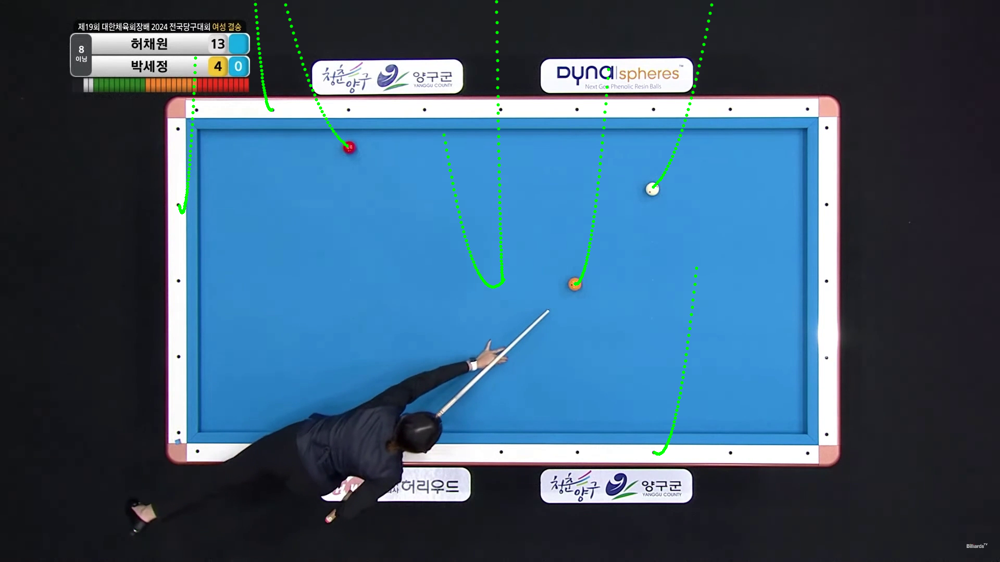


0: 736x1280 1 frame, 4 red balls, 1 table, 1 white ball, 1 yellow ball, 1576.0ms
Speed: 27.3ms preprocess, 1576.0ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)


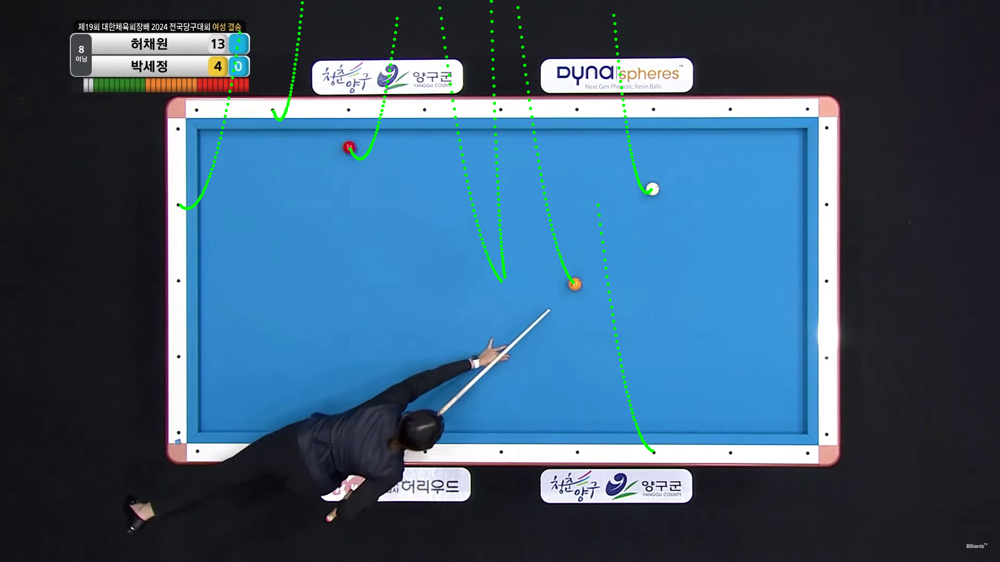


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1600.7ms
Speed: 20.6ms preprocess, 1600.7ms inference, 1.1ms postprocess per image at shape (1, 3, 736, 1280)


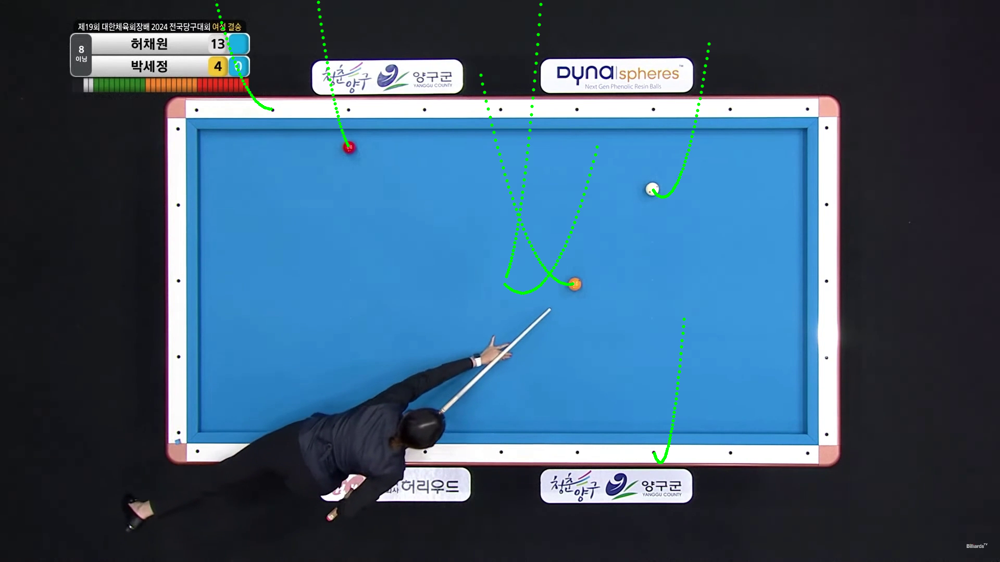


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1780.3ms
Speed: 20.6ms preprocess, 1780.3ms inference, 1.4ms postprocess per image at shape (1, 3, 736, 1280)


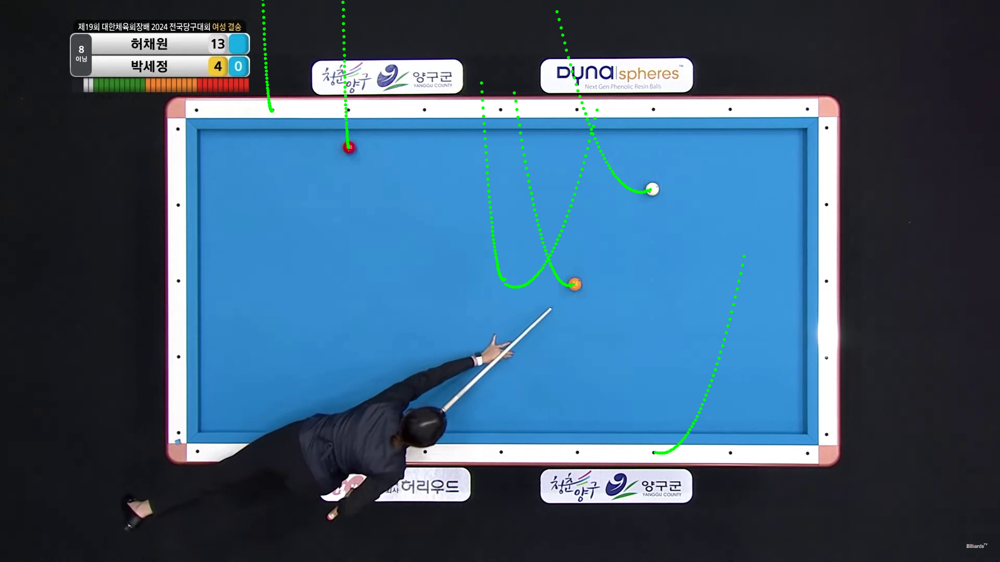


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1690.3ms
Speed: 17.4ms preprocess, 1690.3ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)


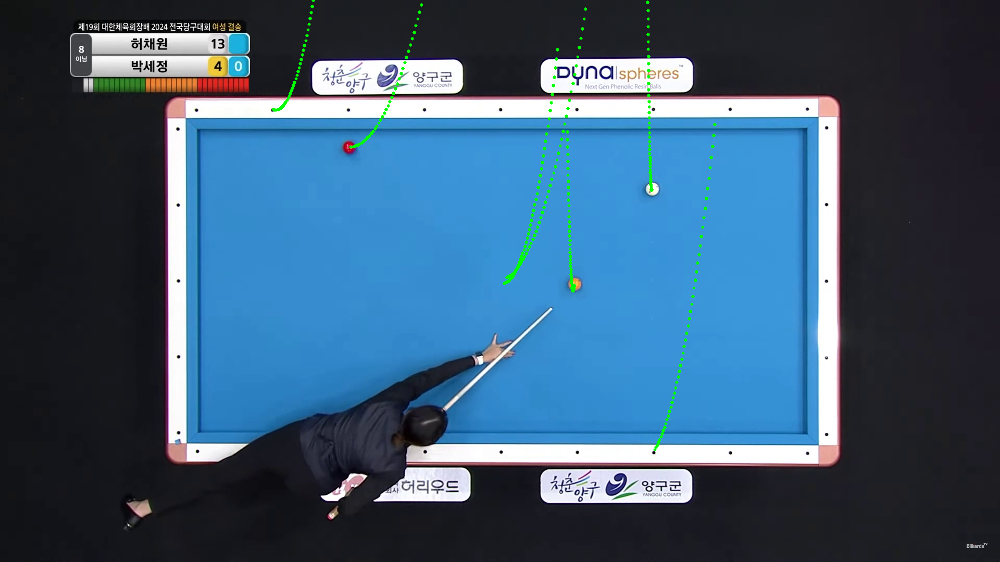


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 2090.1ms
Speed: 20.3ms preprocess, 2090.1ms inference, 1.7ms postprocess per image at shape (1, 3, 736, 1280)


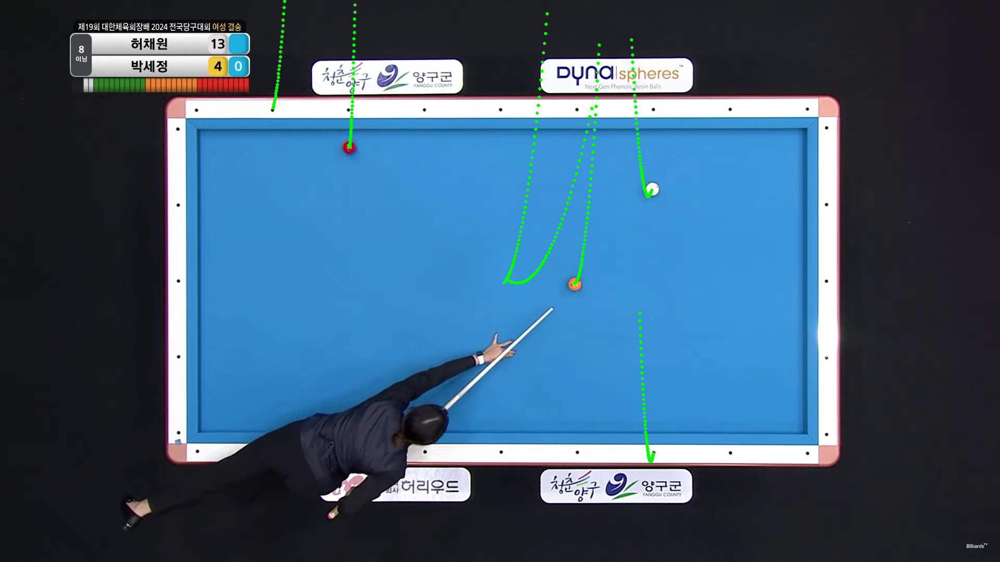


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 2149.4ms
Speed: 16.9ms preprocess, 2149.4ms inference, 1.5ms postprocess per image at shape (1, 3, 736, 1280)


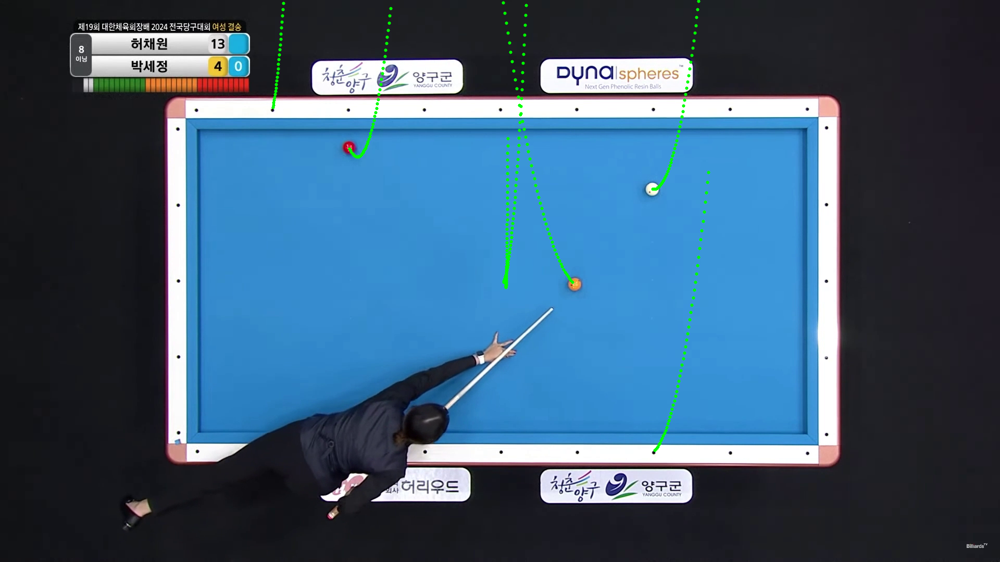


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 2365.2ms
Speed: 22.9ms preprocess, 2365.2ms inference, 4.1ms postprocess per image at shape (1, 3, 736, 1280)


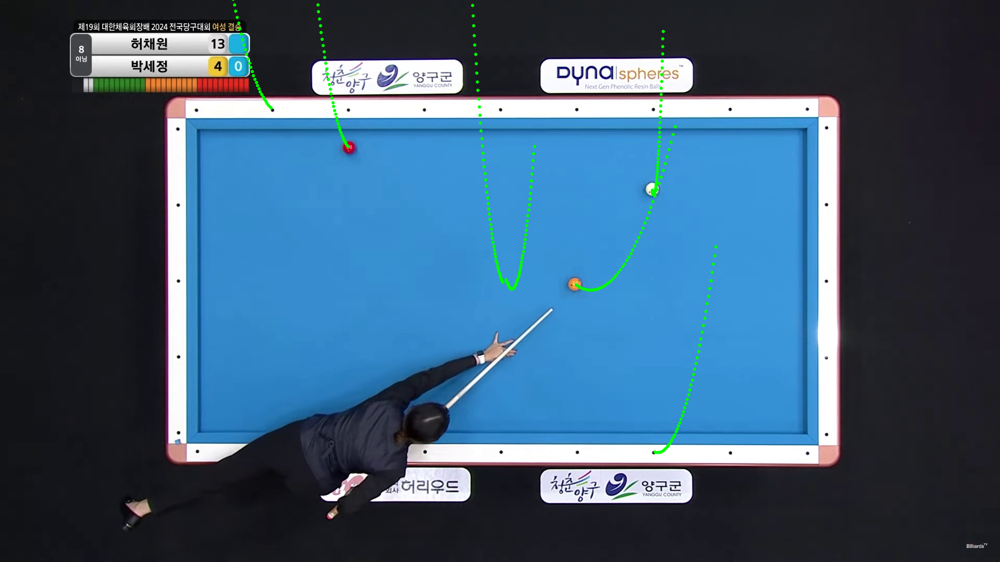


0: 736x1280 1 frame, 3 red balls, 1 table, 1 white ball, 1 yellow ball, 1890.5ms
Speed: 15.9ms preprocess, 1890.5ms inference, 1.1ms postprocess per image at shape (1, 3, 736, 1280)


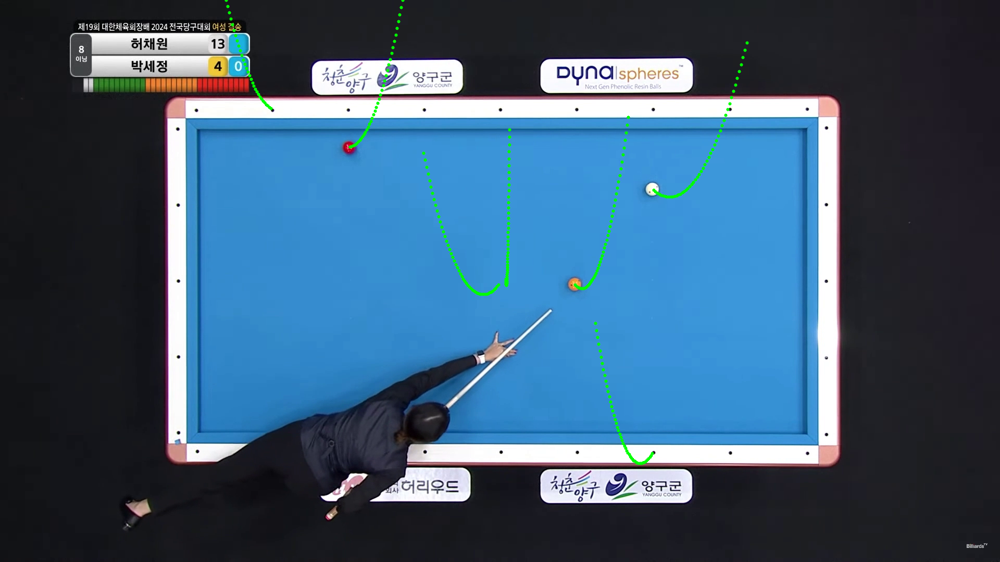

KeyboardInterrupt: 

In [21]:
# 실행 예시
input_video = '/content/drive/MyDrive/AIFFEL_2024/Q-FIT/pre_aiffelthon_practice/practice.mp4'  # 입력 비디오 경로
output_video = '/content/drive/MyDrive/AIFFEL_2024/Q-FIT/test_December_31/result_3/output_pracxtice.mp4'  # 출력 비디오 경로
process_video(input_video, output_video)